# PREP

In [2]:
import cv2
from matplotlib import pyplot as plt
import numpy as np
from pathlib import Path
import requests
import shutil
import os

DATA_PATH = Path('./resources') 

def download_images(dir):
    os.makedirs(dir, exist_ok=True)
    urls = (
        "https://home.agh.edu.pl/~ggolasz/lab1.jpg",
        "https://home.agh.edu.pl/~ggolasz/lab2.jpg",
        "https://home.agh.edu.pl/~ggolasz/lab3_1.jpg",
        "https://home.agh.edu.pl/~ggolasz/lab3_2.png",
    )
    for url in urls:
        filename = url.split('/')[-1]
        if not filename in os.listdir(dir):
            res = requests.get(url, stream = True)
            if res.status_code == 200:
                with open(dir/filename,'wb') as f:
                    shutil.copyfileobj(res.raw, f)
                print('Image sucessfully Downloaded: ',filename)
            else:
                print('Image Couldn\'t be retrieved')

download_images(DATA_PATH)
            

def imshow(im, figsize=[20,10]):
    rcParams_bckp = plt.rcParams['figure.figsize']
    plt.rcParams['figure.figsize'] = figsize
    plt.imshow(cv2.cvtColor(im,cv2.COLOR_BGR2RGB))
    plt.rcParams['figure.figsize'] = rcParams_bckp

# Lab 1

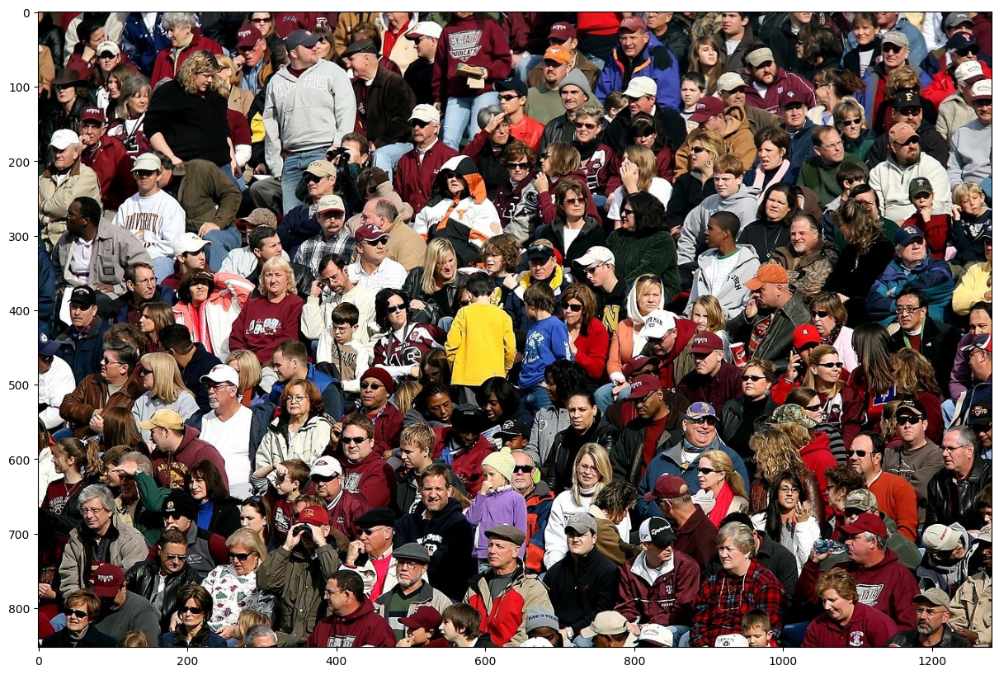

In [3]:
im = cv2.imread(str(DATA_PATH / 'lab1.jpg'))
imshow(im)

In [4]:
im[500][500]

array([ 0,  8, 18], dtype=uint8)

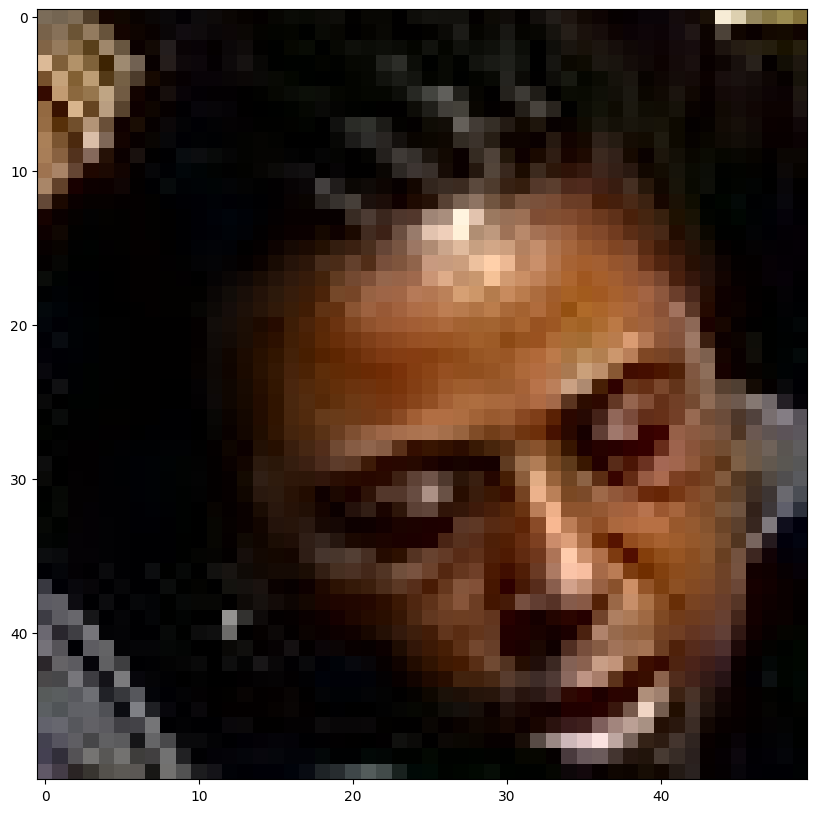

In [5]:
imshow(im[500:550,510:560])

In [6]:
im.shape

(853, 1280, 3)

In [7]:
res_im = cv2.resize(im, [x//2 for x in reversed(im.shape[:2])])
res_im.shape

(426, 640, 3)

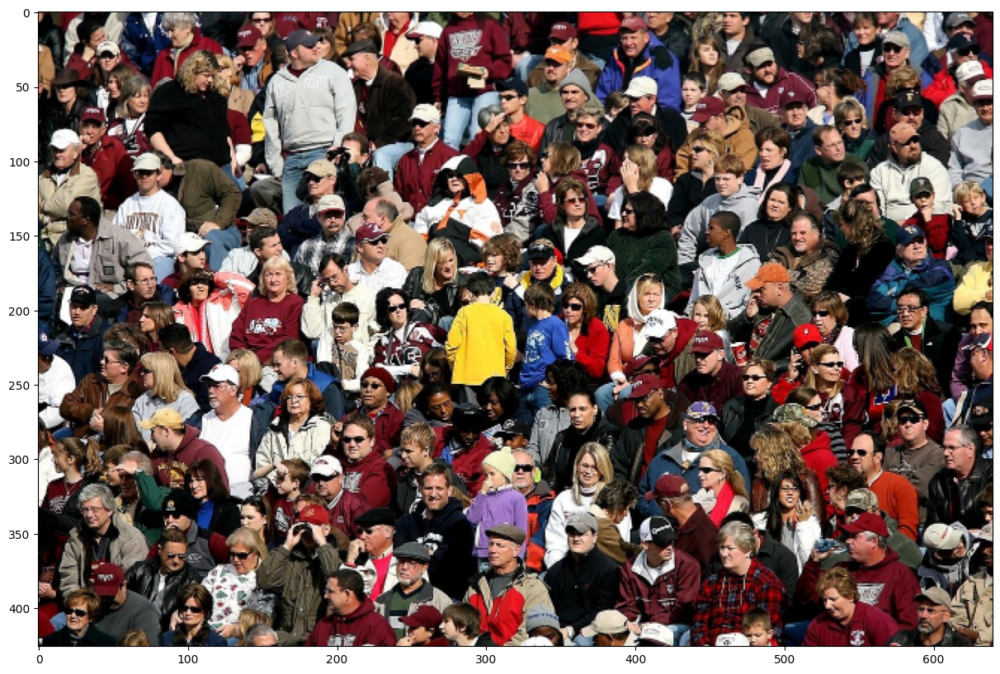

In [8]:
imshow(res_im)

In [9]:
center = [x//2 for x in reversed(im.shape[:2])]
center

[640, 426]

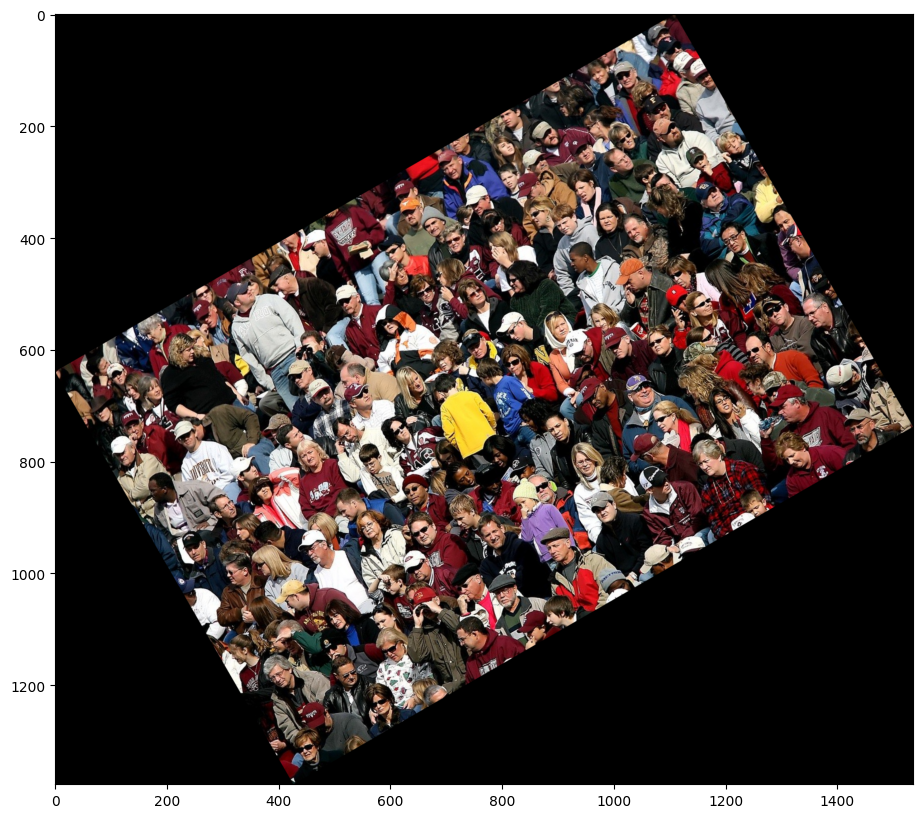

In [10]:
angle = 30
rad_a = 2*np.pi*angle/360 
new_shape = (
    int(np.abs(im.shape[0]*np.cos(rad_a)) + np.abs(im.shape[1]*np.sin(rad_a))),
    int(np.abs(im.shape[1]*np.cos(rad_a)) + np.abs(im.shape[0]*np.sin(rad_a))),
)
rot_m = cv2.getRotationMatrix2D(center, angle, 1)
rot_m[:,2] = rot_m[:,2] + ((np.array(new_shape) - np.array(im.shape[:2]))/2)[::-1]
rot_im = cv2.warpAffine(im, rot_m, new_shape[::-1])
imshow(rot_im)

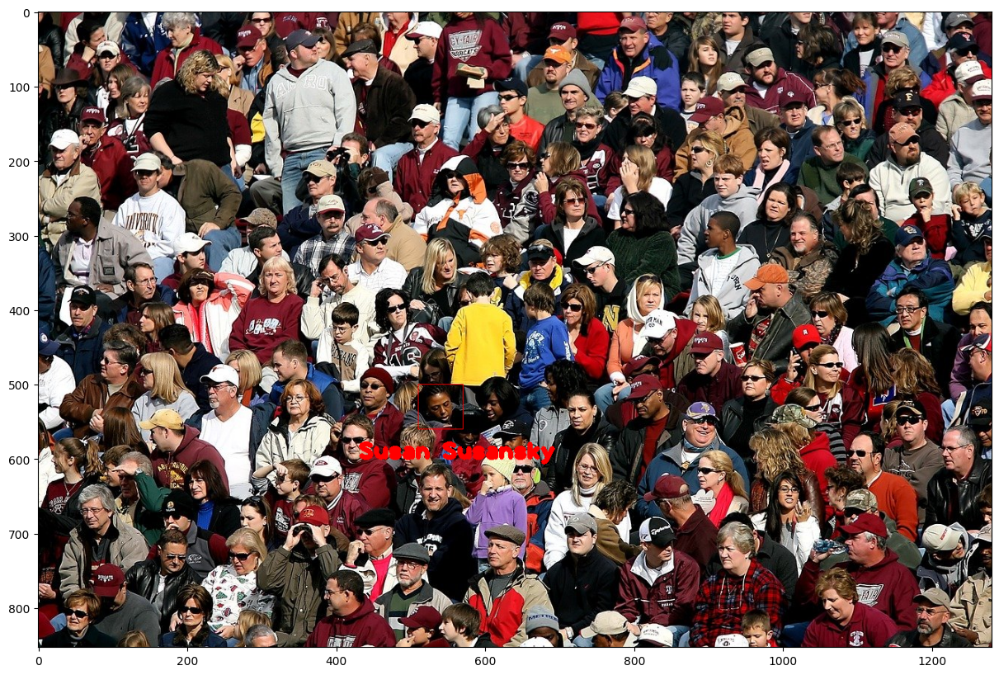

In [11]:
im = cv2.imread(str(DATA_PATH / 'lab1.jpg'))
cv2.rectangle(im, [510,500],[570,560], [0,0,255], 1)
cv2.putText(im, "Susan Susansky", [430,600], 1, 2, [0,0,255], thickness=6)
cv2.imwrite('outputs/square_face.png',im)
imshow(im)

# Lab 2

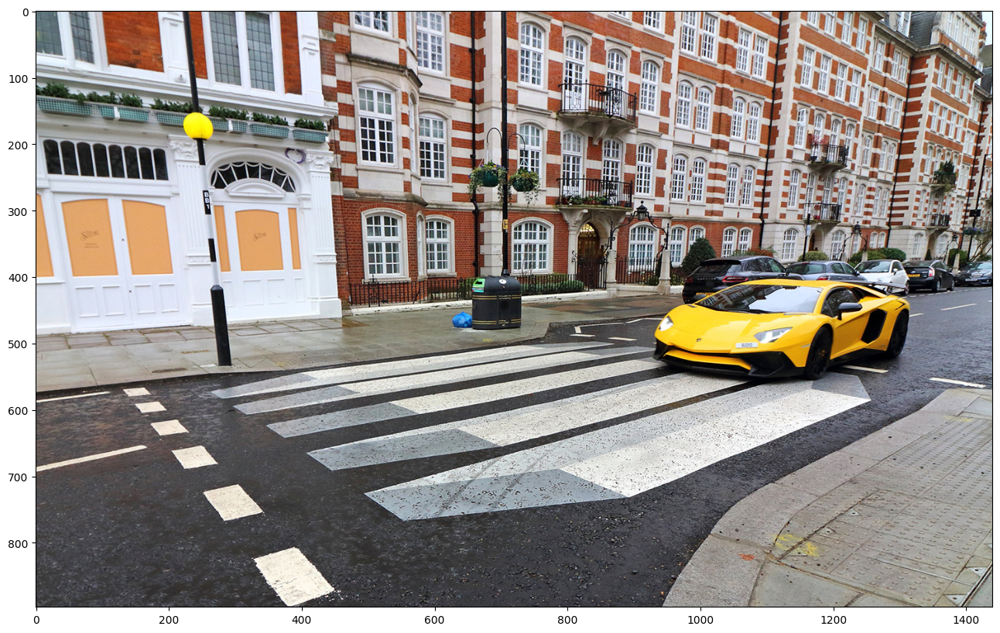

In [12]:
im = cv2.imread(str(DATA_PATH / "lab2.jpg"))
imshow(im)

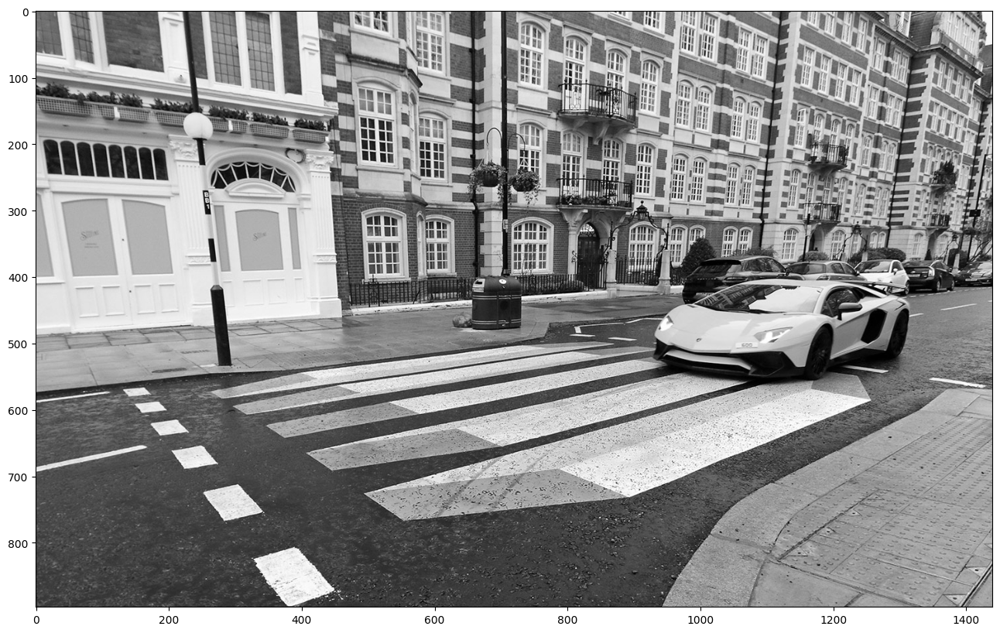

In [13]:
im_gray = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
imshow(im_gray)

Dodanie składowych RGB z wagą 1 doprowadziłoby do wartości >255 więc konieczne jest uśrednienie.

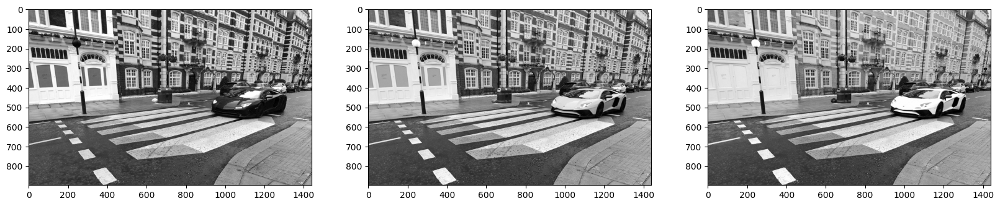

In [14]:
plt.rcParams['figure.figsize'] = [20,10]
for i, im_part in enumerate(cv2.split(im)):
    plt.subplot(1,3,i+1)
    imshow(im_part)

In [15]:
im_hsv = cv2.cvtColor(im, cv2.COLOR_BGR2HSV)

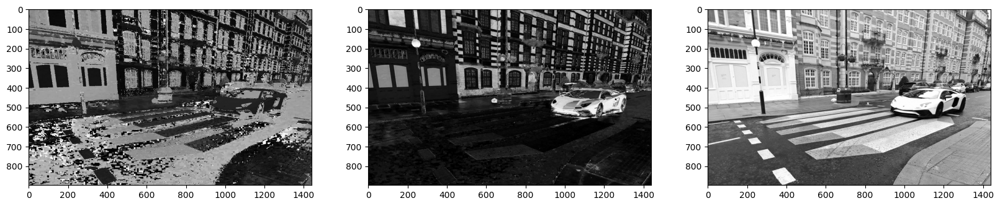

In [16]:
h, s, v = cv2.split(im_hsv)
h = (h*(255/179)).astype(np.uint8)
for i, im_part in enumerate((h, s, v)):
    plt.subplot(1,3,i+1)
    imshow(im_part)

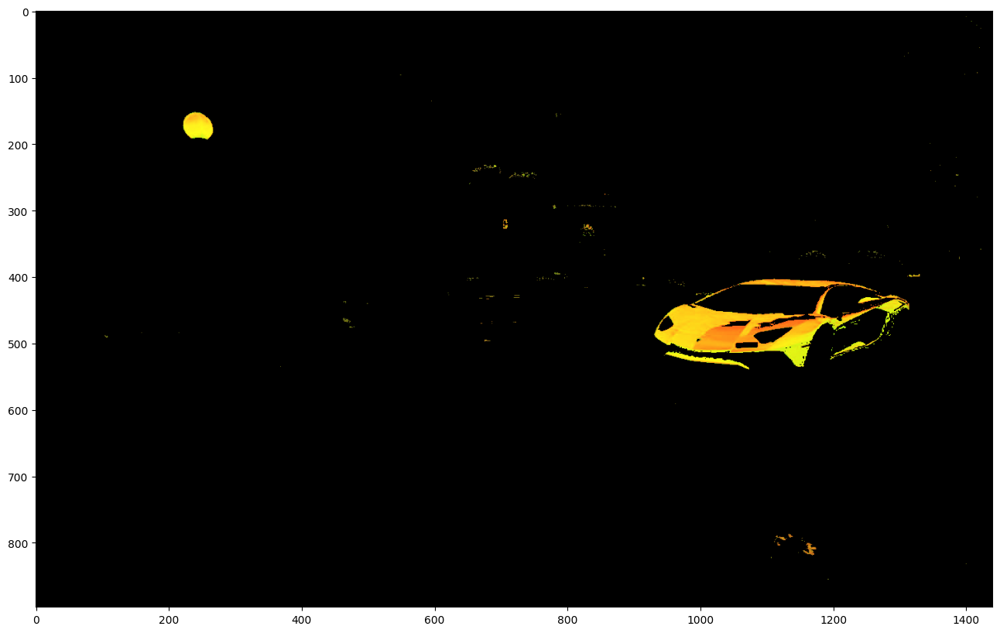

In [17]:
mask = cv2.inRange(im_hsv, (20,100,100), (40,255,255))
im_car = cv2.bitwise_and(im_hsv, im_hsv, mask=mask)
imshow(im_car)

Używamy HSV bo z łatwością można w nim wskazać zakres barw.

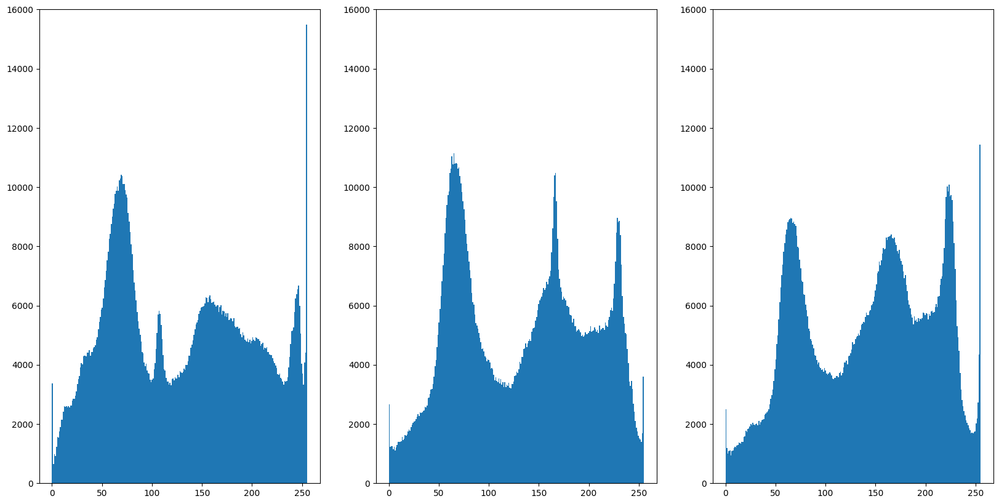

In [18]:
for i in range(3):
    plt.subplot(1,3,i+1)
    plt.ylim([0,16000])
    plt.hist(cv2.split(im)[i].flatten(), bins=256)
plt.show()

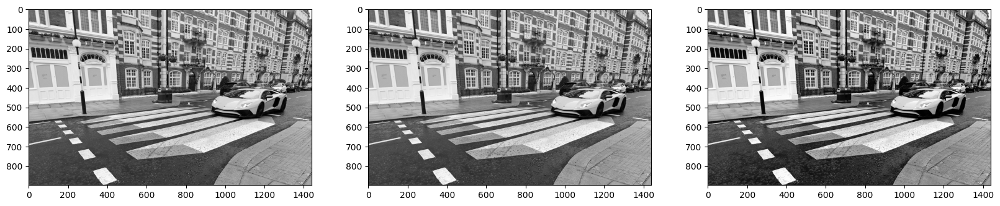

In [19]:
px_min = im_gray.min()
px_max = im_gray.max()
im_contr_spread = (255*((im_gray - px_min)/(px_max-px_min))).astype(np.uint8)
im_contr_spread
im_eq_hist = cv2.equalizeHist(im_gray)
for i, im in enumerate((im_gray, im_contr_spread, im_eq_hist)):
    plt.subplot(1,3,i+1)
    imshow(im)

Rozciągnięcie histogramu daje lepsze efekty. Widać że ilość skrajnych wartości jest dużo większa niż w przypadku rozciągania kontrastu. Jest to naturalne gdyż wyrównanie histogramu rozkłada wartości po równo podczas kiedy rozciągnięcie kontrastu rozciąga już istniejący rozkład wartości.

# Lab 3

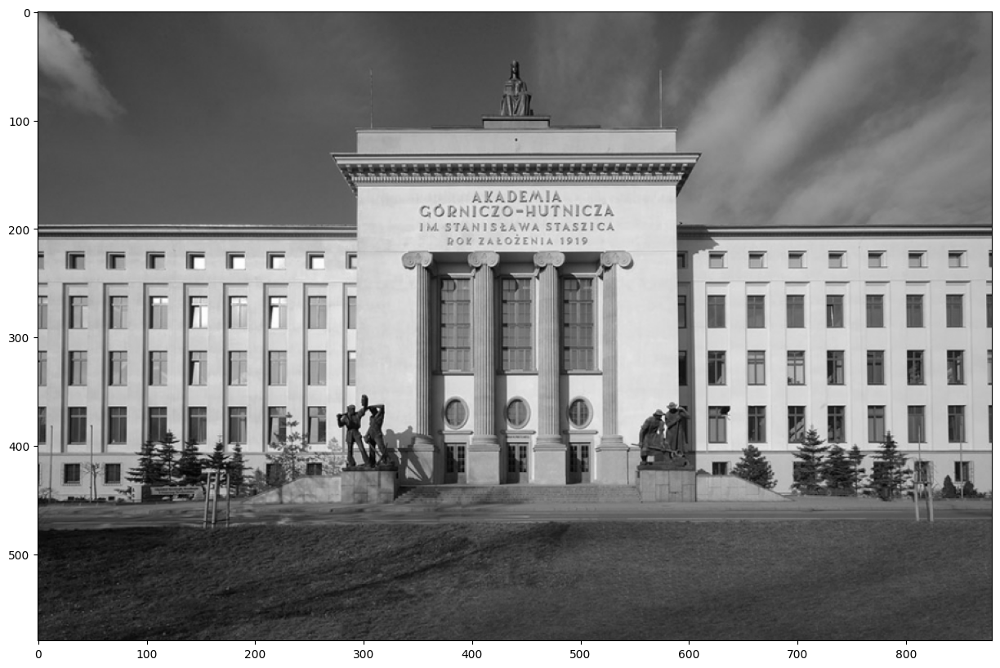

In [20]:
im = cv2.imread(str(DATA_PATH / 'lab3_1.jpg'))
im = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
imshow(im)

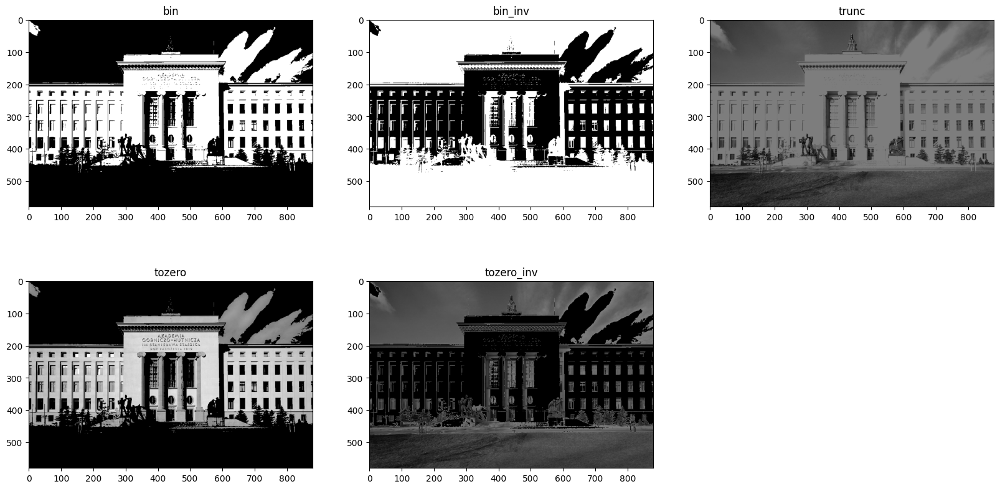

In [21]:
methods = [
    ['bin', cv2.THRESH_BINARY],
    ['bin_inv', cv2.THRESH_BINARY_INV],
    ['trunc', cv2.THRESH_TRUNC],
    ['tozero', cv2.THRESH_TOZERO],
    ['tozero_inv', cv2.THRESH_TOZERO_INV],
]
for i, method in enumerate(methods):
    thr, tmp_im = cv2.threshold(im, 125, 255, method[1])
    plt.subplot(2, 3, i+1)
    plt.title(method[0])
    imshow(tmp_im)  

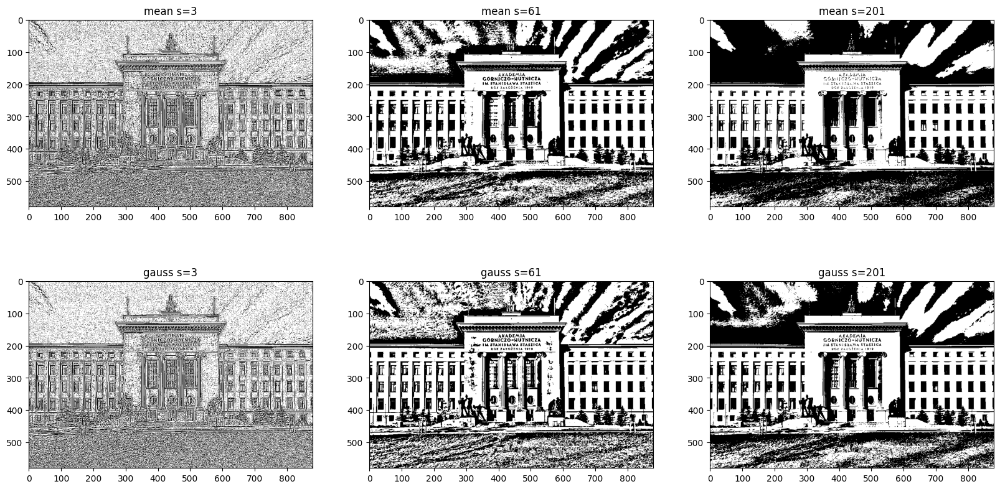

In [22]:
methods = [
    ['mean', cv2.ADAPTIVE_THRESH_MEAN_C],
    ['gauss', cv2.ADAPTIVE_THRESH_GAUSSIAN_C],
]
sizes = [3,61,201]
for i, method in enumerate(methods):
    for j, size in enumerate(sizes):
        tmp_im = cv2.adaptiveThreshold(im, 255, method[1], cv2.THRESH_BINARY, size, 1)
        plt.subplot(len(methods), len(sizes), i*len(sizes)+j+1)
        plt.title(f'{method[0]} s={size}')
        imshow(tmp_im)    

Wraz ze wzrostem rozmiaru sąsiedztwa poprawia się usuwanie artefaktów w postaci szumu. Jednak za duże sąsiedztwo powoduje zanikanie cech zawartych w obrazie. Metoda wykorzystująca rozkład Gaussa jes lepsza. Lepiej zachowuje cechy przy podobnym do metody ze średnimi usuwaniu szumu.

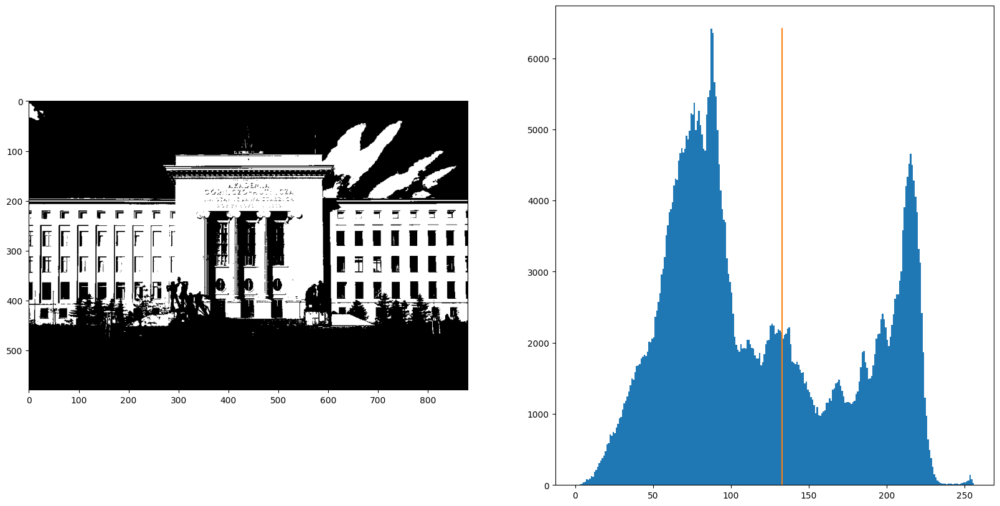

In [23]:
otsu_thr, tmp_im = cv2.threshold(im,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
plt.subplot(1,2,1)
imshow(tmp_im)
plt.subplot(1,2,2)
y, x, _ = plt.hist(im.ravel(), 256, [0,256])
plt.plot([otsu_thr, otsu_thr], [0, max(y)])

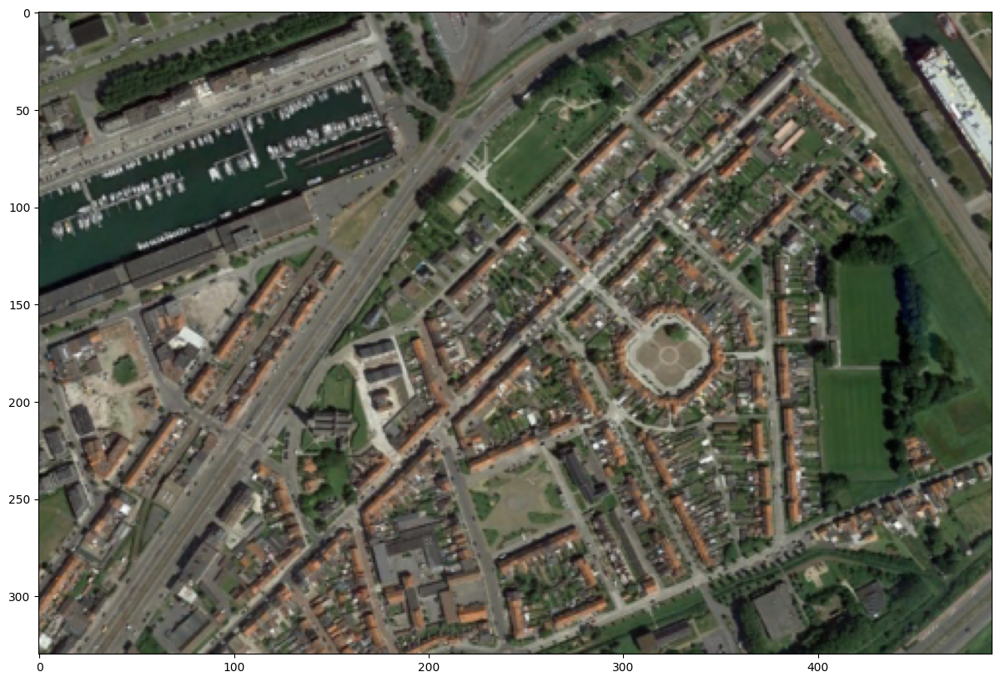

In [24]:
im2 = cv2.imread(str(DATA_PATH / 'lab3_2.png'))
imshow(im2)

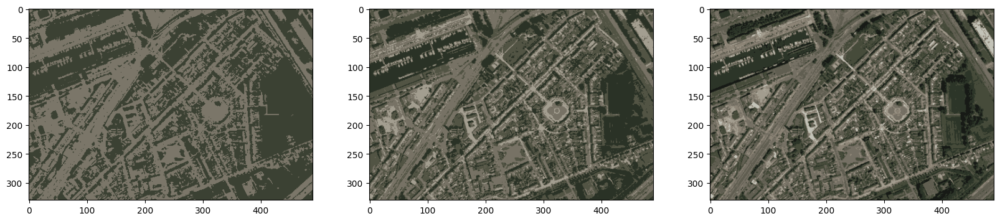

In [25]:
res_im = im2.reshape((-1,3))
res_im = np.float32(res_im)
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)

for i, k in enumerate((2,4,8)):
    ret, lab, cent = cv2.kmeans(res_im, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)
    cent = np.uint8(cent)
    tmp_im = cent[lab.flatten()]
    tmp_im = tmp_im.reshape((im2.shape))
    plt.subplot(1,3,i+1)
    imshow(tmp_im)

Wygląda na to że w zdjęciu 2 udało nam się wyodrębnić drogi. Niestety nawet przy największej ilości klastrów nie udało się wyodrębnić na przykład dachów. Najpewniej reprezentują zbyt małą część obrazu.

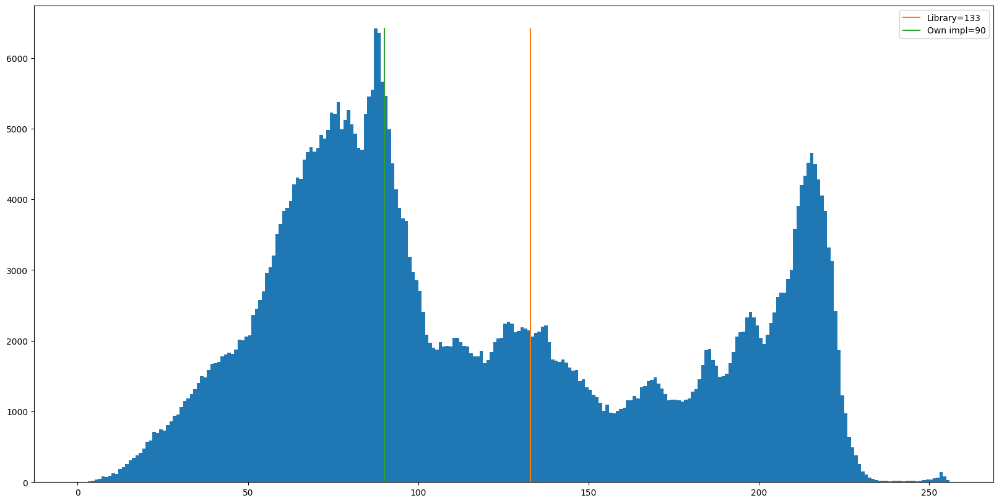

In [39]:
im_otsu = cv2.resize(im, [x//4 for x in reversed(im.shape[:2])])

otsu_thr, _ = cv2.threshold(im_otsu,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
y, x, _ = plt.hist(im.ravel(), 256, [0,256])

crits = []
for th in range(255):
    thresh = np.array([[1 if px > th else 0 for px in row ] for row in im_otsu])
    
    weights = np.unique(thresh, return_counts=True)[1]/(im_otsu.shape[0] * im_otsu.shape[1])
    if len(weights) != 2:
        continue
    w0, w1 = weights

    cls_0 = np.array([px for row in im_otsu for px in row if px > th])
    cls_1 = np.array([px for row in im_otsu for px in row if px <= th])
    
    v0 = np.var(cls_0)
    v1 = np.var(cls_1)

    crits.append([w0 * v0 + w1 * v1, th])
otsu_thr_own = sorted(crits, key=lambda x:x[0])[-1][1]

plt.plot([otsu_thr, otsu_thr], [0, max(y)], label=f'Library={int(otsu_thr)}')
plt.plot([otsu_thr_own, otsu_thr_own], [0, max(y)], label=f'Own impl={otsu_thr_own}')
plt.legend()


Próg różni się od implementacji bibliotecznej.

# Lab 4

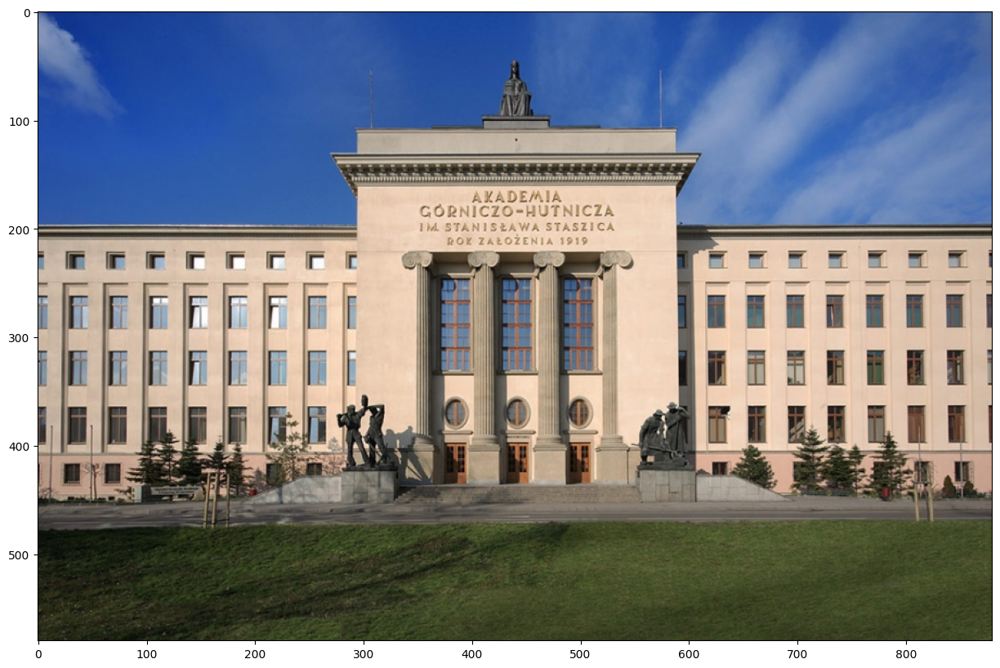

In [26]:
im = cv2.imread(str(DATA_PATH / "lab3_1.jpg"))
imshow(im)

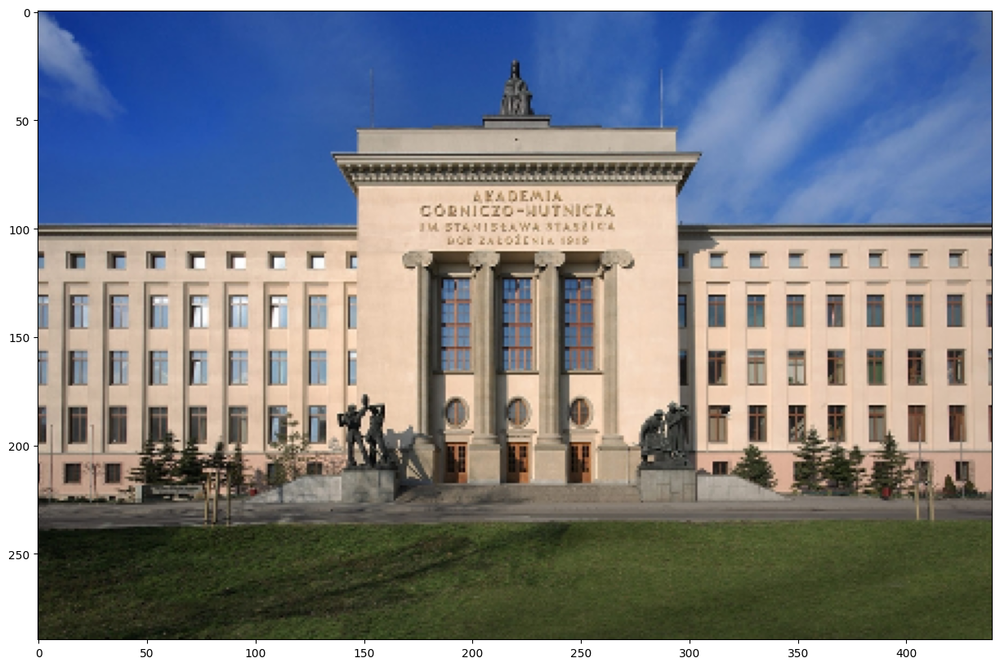

In [27]:
im_small = cv2.resize(im, None, fx=0.5, fy=0.5, interpolation=cv2.INTER_NEAREST)
imshow(im_small)

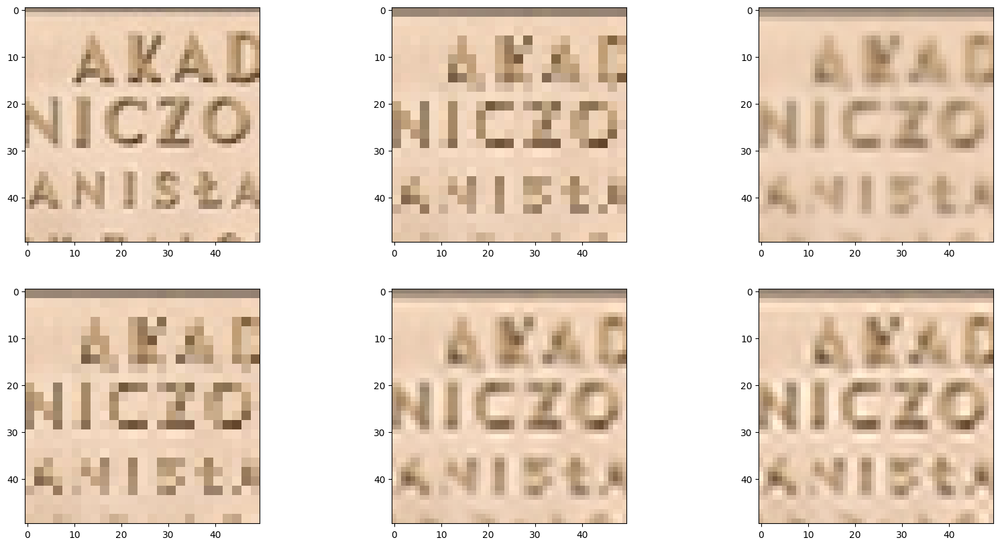

In [28]:
interpolations = (None, cv2.INTER_NEAREST, cv2.INTER_LINEAR, cv2.INTER_AREA, cv2.INTER_CUBIC, cv2.INTER_LANCZOS4)
for i, intpol in enumerate(interpolations):
    plt.subplot(2,3,i+1)
    if intpol is None:
        imshow(im[160:210, 390:440])
        continue
    imshow(cv2.resize(im_small, None, fx=2, fy=2, interpolation=intpol)[160:210, 390:440])

Najlepszą interpolacją zdaje się być metoda sinusoidalna. Obraz jest najbardziej ostry i najbardziej czytelny.

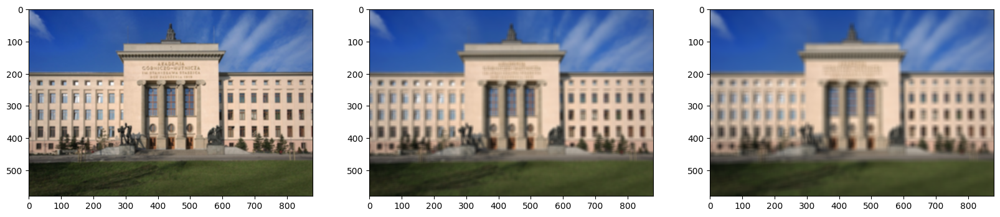

In [29]:
blur_kernels = ([(5,5)],[(10,10)],[(15,15)])
for i, k_size in enumerate(blur_kernels):
    plt.subplot(1,3,i+1)
    imshow(cv2.blur(im, *k_size))

Obraz się rozmywa. Rozmycie jest tym większe im większy jest rozmiar filtra.

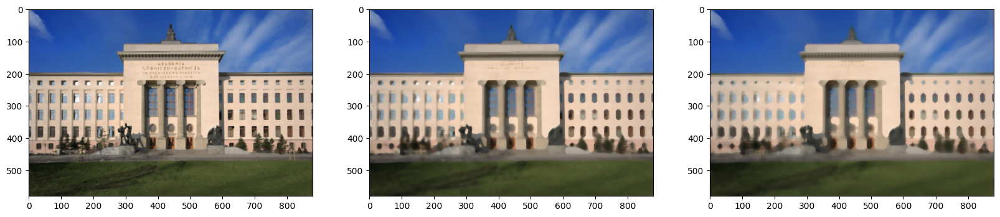

In [30]:
median_kernels = ([5],[11],[15])
for i, k_size in enumerate(median_kernels):
    plt.subplot(1,3,i+1)
    imshow(cv2.medianBlur(im, *k_size))

W tym przypadku zamiast rozmycia mamy efekt w którym dane kolory zaczynają dominować i zachodzić na obiekty innego koloru wewnątrz ich obrębów.

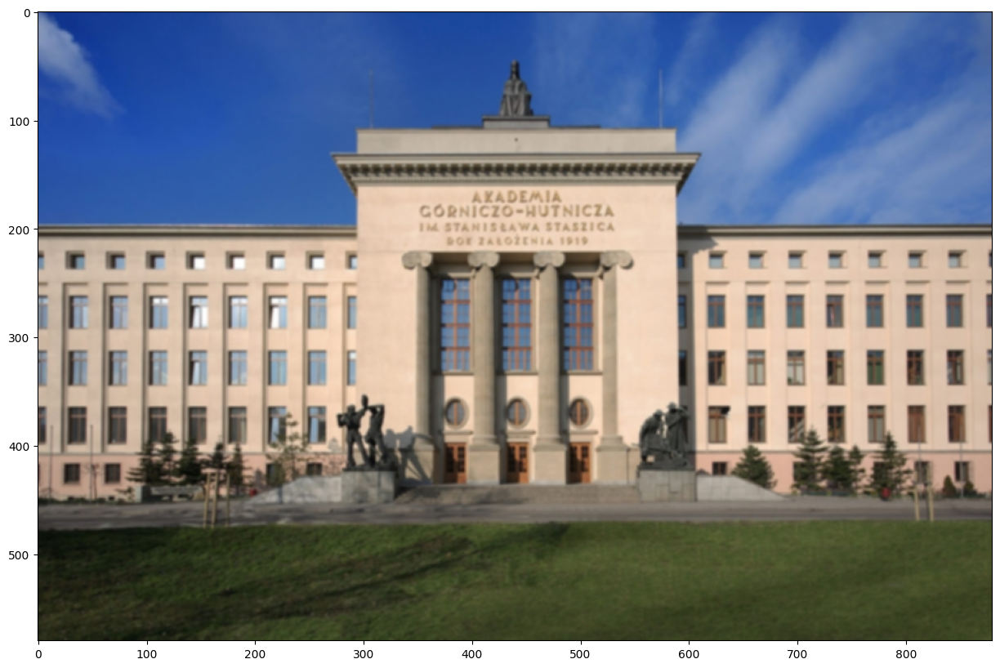

In [31]:
imshow(cv2.GaussianBlur(im, (5,5), 0))

Filtr gaussowski zdaje się wygładzać obraz podobnie jak filtr uśredniający ale przy równoczesnym zachowaniu wydatnych cech obrazu.

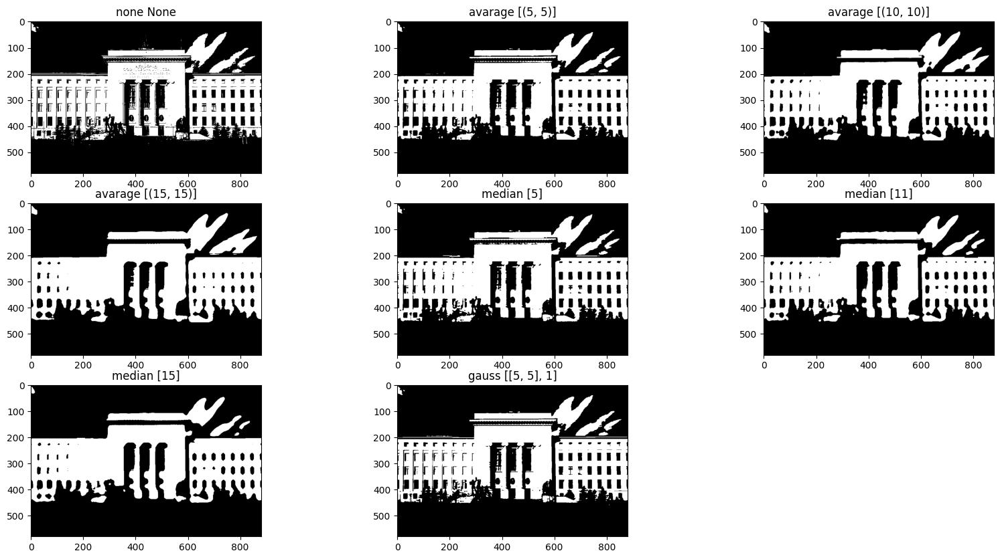

In [32]:
methods = {
    'none': None,
    'avarage': cv2.blur,
    'median': cv2.medianBlur,
    'gauss': cv2.GaussianBlur
}
methods_and_kernels = (
    ('none', [None]),
    ('avarage', blur_kernels),
    ('median', median_kernels),
    ('gauss', [[[5,5], 1]])
)
n_im = sum([len(x[1]) for x in methods_and_kernels])
i = 1
for method_name, kernels in methods_and_kernels:
    for kernel in kernels:
        plt.subplot(n_im//3 + (1 if n_im%3 else 0),3,i)
        plt.title(f'{method_name} {kernel}')
        if kernel is None:
            imshow(cv2.threshold(cv2.cvtColor(im, cv2.COLOR_BGR2GRAY),0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1])
            i += 1
            continue
        im_blurred = methods[method_name](im, *kernel)
        im_blurred_bw = cv2.cvtColor(im_blurred, cv2.COLOR_BGR2GRAY)
        imshow(cv2.threshold(im_blurred_bw,0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)[1])
        i += 1

Wszystkie binaryzacje po filtracji mają mniej szczegółów ale też lepiej wyodrębniają poszczególne elementy od tła (gmach i chmury od trawy, drogi i nieba).

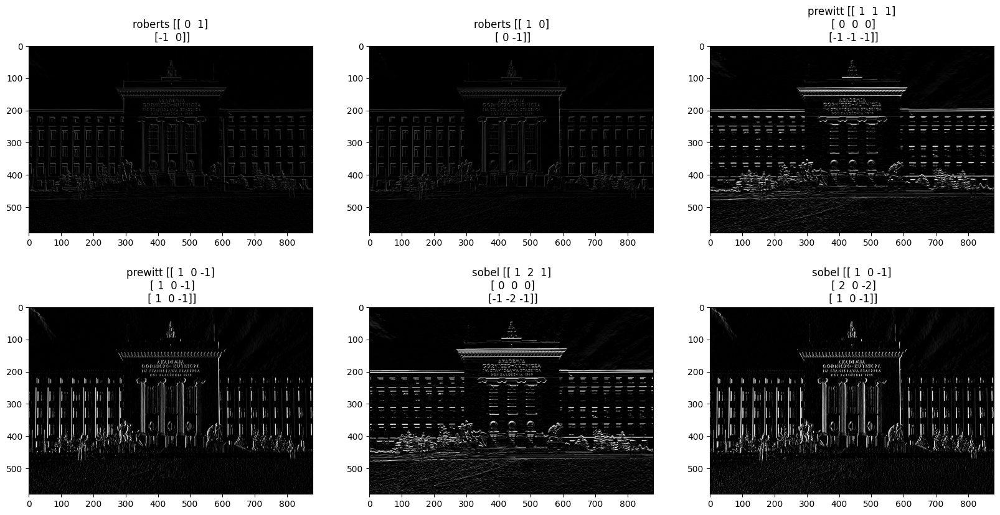

In [33]:
roberts = [
    np.array([[0,1],[-1,0]]),
    np.array([[1,0],[0,-1]])
]
prewitt = [
    np.array([[1,1,1],[0,0,0],[-1,-1,-1]]),
    np.array([[1,0,-1],[1,0,-1],[1,0,-1]])
]
sobel = [
    np.array([[1,2,1],[0,0,0],[-1,-2,-1]]),
    np.array([[1,0,-1],[2,0,-2],[1,0,-1]])
]
im_bw = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
n_im = len([*roberts, *prewitt, *sobel])
i = 1
for kernel_name, kernels in zip(["roberts", "prewitt", "sobel"],[roberts, prewitt, sobel]):
    for kernel in kernels:
        plt.subplot(n_im//3 + (1 if n_im%3 else 0),3,i)
        plt.title(f'{kernel_name} {kernel}')    
        imshow(cv2.filter2D(im_bw, -1, kernel))
        i+=1